In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters,
                   hexagon_parameters)

In [3]:
kdata = make_k(-40)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
M_alphas, alpha_inv = make_M_alphas(alphas)

sigmas = singular_points_new(k)
assert sigmas == [inf, cusp(w/2)]

In [6]:
max(a.denominator().norm() for a in alphas)

40

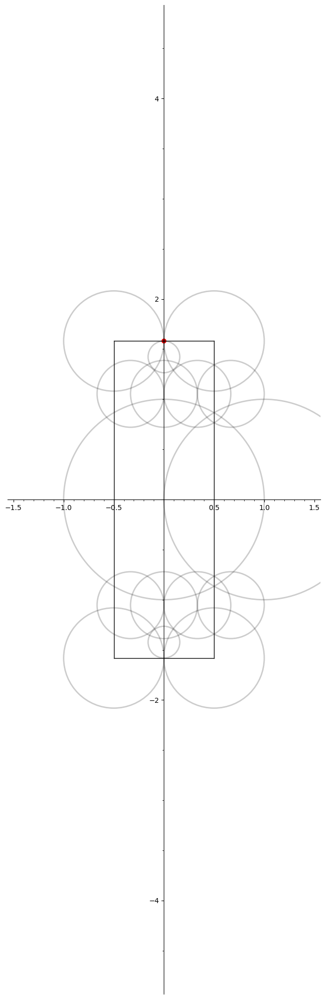

In [8]:
plot_FunDomain_projection(k, alphas, sigmas).show(figsize=[20,20])

In [6]:
polys, hemis = all_polyhedra(k)
print("{} polyhedra constructed".format(len(polys)))

New orbit from P_0=[-3/7*w - 1/14, 3/196]: {0, 1, 2, 3}
New orbit from P_4=[4/15*w + 1/2, 7/180]: {8, 4, 6}
New orbit from P_5=[-4/15*w + 1/2, 7/180]: {9, 5, 7}
New orbit from P_10=[3/10*w + 1/6, 13/180]: {10, 11, 14}
New orbit from P_12=[-3/10*w - 1/6, 13/180]: {12, 13, 15}
Found [[10, 11, 14], [9, 5, 7], [0, 1, 2, 3], [8, 4, 6], [12, 13, 15]] orbits:
Constructed 5 polyhedra
Faces: [[3, 4, 4, 4, 3], [4, 4, 3, 3, 6, 3, 4, 3], [6, 4, 4, 4, 6, 4, 4, 4], [4, 4, 3, 3, 3, 6, 4, 3], [4, 4, 3, 3, 4]]
New orbit from R_0=[6/11*w - 1/22, 1/44]: {0, 1, 2, 3}
Found 1 orbits with representative points [[0, 1, 2, 3]]:
Constructed 1 polyhedra
Faces: [[3, 3, 4, 3, 3]]
6 polyhedra constructed


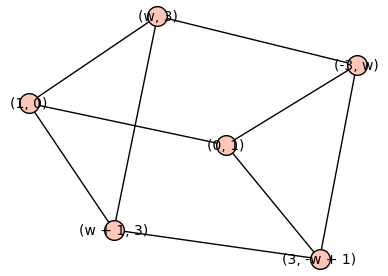

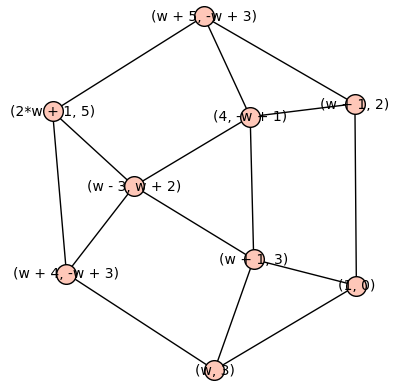

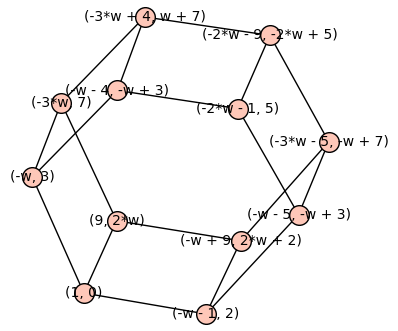

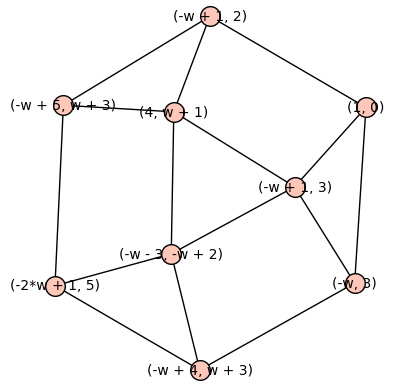

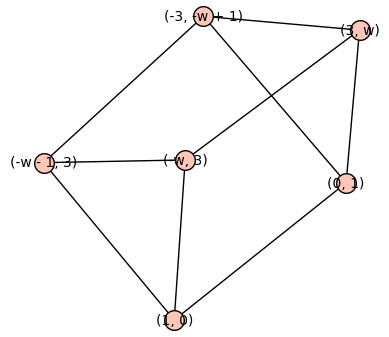

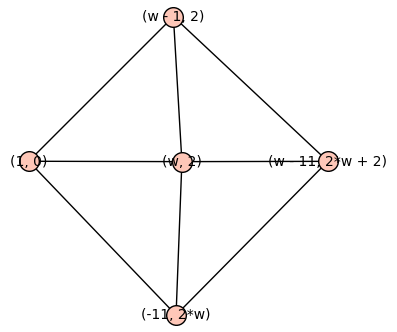

In [7]:
for G in polys: show(G)

In [8]:
triangles = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [9]:
[len(t) for t in [aaa_triangles, aas_triangles, squares, hexagons]]

[12, 4, 19, 4]

In [10]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
aas_triangles0 = aas_triangle_gl2_orbit_reps(aas_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [11]:
[len(t) for t in [aaa_triangles0, aas_triangles0, squares0, hexagons0]]

[2, 2, 4, 1]

In [12]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

[[[0, 2, 0, 2], [0, 0, 0]],
 [[6, 1, 7, 0], [w + 1, 0, -w]],
 [[8, 1, 9, 1], [w + 1, 0, -w]],
 [[2, 8, 3, 9], [0, 0, 0]]]

In [13]:
[aas_triangle_parameters(T, alphas, M_alphas, sigmas) for T in aas_triangles0]

[[[1, 1, 1], 1], [[8, 1, 1], -w]]

In [14]:
aaa_triangles0

[[[-w:-3], oo, [-w + 1:-3]], [[0:1], oo, [1:1]]]

In [15]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w:-3], oo, [-w + 1:-3]]]

In [16]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

[[2, 7, 4]]

In [17]:
[hexagon_parameters(H, alphas, M_alphas) for H in hexagons0]

[[[2, 1, 1, 2, 2, 1], [0, -1, 0, 1, 0]]]

In [18]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object

In [19]:
from polyhedra import all_poly_types, poly_types

In [20]:
poly_types(polys)

{'tetrahedron': 0,
 'cube': 0,
 'triangular prism': 2,
 'square prism': 1,
 'hexagonal prism': 1,
 'hexagonal cap': 2,
 'truncated tetrahedron': 0,
 'cuboctahedron': 0}

In [21]:
all_poly_types(polys)

['triangular prism',
 'hexagonal cap',
 'hexagonal prism',
 'hexagonal cap',
 'triangular prism',
 'square prism']